# **Panoptic Segmentation with Mask2Former Using the LaRS Dataset**

In this notebook, I fine-tune the [Mask2Former](https://huggingface.co/docs/transformers/model_doc/mask2former) model available on [Hugging Face](https://huggingface.co/) for the task of panoptic segmentation using the [LaRS](https://arxiv.org/pdf/2308.09618) dataset.

The **Mask2Former (Masked-attention Mask Transformer)** model features a universal image segmentation architecture that can handle any segmentation task (panoptic, instance, or semantic), unlike other models that require specific architectures for each task. In addition, Mask2Former offers significant improvements in performance and efficiency compared to its predecessor, [MaskFormer](https://huggingface.co/docs/transformers/model_doc/maskformer).

*Mask2Former Model Architecture (taken from the [original paper](https://arxiv.org/pdf/2112.01527)):*

<img src="https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/transformers/model_doc/mask2former_architecture.jpg" width="800"/>

The **LaRS (Lakes, Rivers and Seas)** dataset is the largest and most diverse panoptic dataset for maritime obstacle detection. It consists of 4,006 keyframes with pixel-level annotations, divided into 2,605 for training, 198 for validation, and 1,203 for testing (the test set is not publicly available). The dataset comprises 11 classes, divided into 8 *thing* classes and 3 *stuff* classes. However, since the original validation set is too small and the test annotations are not publicly available, the original training and validation sets were merged and then randomly split into 80% (2240) for training and 20% (561) for validation. This ensures a similar proportion of *thing* class instances in both sets, balancing the dataset and making the validation set more representative for evaluation.

## **Imports**

In [ ]:
# Install the Datasets and TorchMetrics libraries
!pip install datasets -q
!pip install torchmetrics -q

In [24]:
from transformers import (
    AutoImageProcessor, AutoModelForUniversalSegmentation,
    TrainingArguments, Trainer, EarlyStoppingCallback
)
from datasets import load_from_disk
import torch
from torchmetrics.detection import PanopticQuality
import albumentations as A
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import plotly.graph_objects as go
import seaborn as sns
import colorcet as cc
from tqdm.auto import tqdm
from google.colab import drive
from IPython.display import display, Image as DisplayImage
import imageio.v2 as imageio
from glob import glob
import requests
import random
import shutil
import json
import cv2
import os
import io

# Necessary in Colab with Hugging Face to prevent path-related encoding errors
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [3]:
# Mount Google Drive in Colab
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


## **Parameters**

The LaRS dataset mostly contains high-resolution images, so it would be advisable to fine-tune Mask2Former with an image size of at least `(512, 1024`). However, due to the computational limitations of the free Google Colab GPU, the maximum usable image size is `(512, 832)`, even when fine-tuning the smallest version of Mask2Former, **Mask2Former-Swin-Tiny**. It is also not possible to use Colab's TPU because Mask2Former is based on PyTorch and there are no TensorFlow versions of its models available.

In [4]:
model_name = "facebook/mask2former-swin-tiny-coco-panoptic"
checkpoint_folder = "/content/drive/MyDrive/checkpoints/PanopticSegmentation_Mask2Former-Tiny_LaRS"
trained_model_path = "/content/drive/MyDrive/models/PanopticSegmentation_Mask2Former-Tiny_LaRS"
zip_dataset_path = "/content/drive/MyDrive/Datasets/LaRS.zip"
dataset_dir = os.path.basename(zip_dataset_path).split(".")[0]
image_size = (512, 832) #(512, 1024)
batch_size = 4
epochs = 25
patience = 7
ignore_cls, ignore_id = 255, 0
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## **Load the Dataset**

The download, along with all the preprocessing and analysis of the LaRS, has been completed in the following notebook: [Preprocessing_LaRS](https://github.com/JersonGB22/ImageSegmentation-TensorFlow-PyTorch/blob/main/Preprocessing/Preprocessing_LaRS.ipynb).

In [5]:
# Unzip the dataset
!unzip -q $zip_dataset_path

In [ ]:
# Load the processed dataset and its metadata
dataset = load_from_disk(dataset_dir)

with open(os.path.join(dataset_dir, "metadata.json"), "r") as file:
  metadata = json.load(file)

dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'mask', 'segments_info'],
        num_rows: 2240
    })
    val: Dataset({
        features: ['image', 'mask', 'segments_info'],
        num_rows: 561
    })
})

In [ ]:
# Map class IDs to labels and colors from metadata
id2label = {dic["id"]: dic["name"] for dic in metadata}
label2id = {dic["name"]: dic["id"] for dic in metadata}
id2color = {dic["id"]: tuple(dic["color"]) for dic in metadata}
num_classes = len(id2label)

# Extract the IDs of "thing" and "stuff" classes, and assign unique colors to the "stuff" classes
things = [dic["id"] for dic in metadata if dic["isthing"]]
stuffs = [dic["id"] for dic in metadata if not dic["isthing"]]
stuff_colors = {tuple(dic["color"]) for dic in metadata if not dic["isthing"]}

# Generate a distinct color palette using Glasbey colormap  
palette = list({
    (int(r * 255), int(g * 255), int(b * 255))
    for r, g, b in sns.color_palette(cc.glasbey)
})

print(num_classes)
print(id2label)

11
{0: 'static obstacle', 1: 'water', 2: 'sky', 3: 'boat/ship', 4: 'row boats', 5: 'paddle board', 6: 'buoy', 7: 'swimmer', 8: 'animal', 9: 'float', 10: 'other'}


## **Prepare the Dataset for Training**

In [ ]:
# Download the image processor for the segmentation model
image_processor = AutoImageProcessor.from_pretrained(
    model_name,
    size=image_size,
    resample=Image.Resampling.NEAREST,
    ignore_index=ignore_id,
    do_reduce_labels=False,
    num_labels=num_classes
)
image_processor

Mask2FormerImageProcessor {
  "do_normalize": true,
  "do_reduce_labels": false,
  "do_rescale": true,
  "do_resize": true,
  "ignore_index": 0,
  "image_mean": [
    0.48500001430511475,
    0.4560000002384186,
    0.4059999883174896
  ],
  "image_processor_type": "Mask2FormerImageProcessor",
  "image_std": [
    0.2290000021457672,
    0.2239999920129776,
    0.22499999403953552
  ],
  "num_labels": 11,
  "resample": 0,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 512,
    "width": 832
  },
  "size_divisor": 32
}

To combat overfitting and improve the model's performance, the [Albumentations](https://albumentations.ai/docs/) library will be used for data augmentation. This fast and flexible image augmentation library is widely used in deep learning applications.

Next, to prepare the training and validation datasets for fine-tuning, the `preprocess_with_augmentation` function is applied. This function resizes, scales, normalizes, and converts the images, instance masks, and segment information (a dictionary mapping instance IDs to class IDs) into the appropriate format. It also applies data augmentation only to the training dataset.

The `with_transform` method from the Datasets library is used, allowing transformations to be applied dynamically each time a dataset item is loaded. Finally, the `collate_fn` function is defined, which will be used to create batches containing only the necessary elements for model fine-tuning.

In [ ]:
# Define the transformations for data augmentation
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.Affine(
        scale=(0.8, 1.2),
        translate_percent=(0.0, 0.1),
        rotate=(-10, 10),
        shear=(0.0, 0.0),
        mask_interpolation=cv2.INTER_NEAREST,
        fill=0,
        fill_mask=ignore_id,
        border_mode=cv2.BORDER_CONSTANT,
        p=0.5
    ),
    A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.3, p=0.5),
], p=1.0)


# Function for dataset preprocessing and data augmentation
def preprocess_with_augmentation(samples, transform=None):
  images, masks, inst2class_list = [], [], []

  for image, mask, segments_info in zip(samples["image"], samples["mask"], samples["segments_info"]):
    image = np.array(image)
    mask = np.array(mask)
    inst2class = {
        segment_info["id"]: segment_info["category_id"]
        for segment_info in segments_info
    }

    if transform:
      transformed = transform(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]

    images.append(image)
    masks.append(mask)
    inst2class_list.append(inst2class)

  inputs = image_processor(
      images=images,
      segmentation_maps=masks,
      instance_id_to_semantic_id=inst2class_list,
      return_tensors="pt"
  )
  for k, v in inputs.items():
    samples[k] = v

  return samples


# Function to create a batch from a dataset
def collate_fn(batch):
  pixel_values = torch.stack([sample["pixel_values"] for sample in batch])
  pixel_mask = torch.stack([sample["pixel_mask"] for sample in batch])
  mask_labels = [sample["mask_labels"] for sample in batch]
  class_labels = [sample["class_labels"] for sample in batch]

  return {
      "pixel_values": pixel_values,
      "pixel_mask": pixel_mask,
      "mask_labels": mask_labels,
      "class_labels": class_labels
  }

In [ ]:
train_dataset = dataset["train"].with_transform(lambda x: preprocess_with_augmentation(x, transform))
val_dataset = dataset["val"].with_transform(lambda x: preprocess_with_augmentation(x))

In [ ]:
# Take a batch from the training dataset
samples = train_dataset[:batch_size]

for k, v in samples.items():
  if k in dataset["train"].features.keys():
    continue

  if isinstance(v, torch.Tensor):
    print(k, v.shape)
  else:
    print(k, len(v), v[2].shape)

pixel_values torch.Size([4, 3, 512, 832])
pixel_mask torch.Size([4, 512, 832])
mask_labels 4 torch.Size([6, 512, 832])
class_labels 4 torch.Size([6])


## **Train the Model**

Before fine-tuning a model, it is crucial to understand the loss functions that will be used. According to the [official paper](https://arxiv.org/pdf/2112.01527) of Mask2Former and its [official implementation](https://github.com/huggingface/transformers/blob/d1b92369ca193da49f9f7ecd01b08ece45c2c9aa/src/transformers/models/mask2former/modeling_mask2former.py#L490) in the Hugging Face Transformers library, Mask2Former for universal image segmentation jointly integrates class and mask prediction, using **Hungarian matching** before calculating the losses. The Hungarian matching is an optimization method that optimally pairs the model’s predictions with the reference labels by minimizing a cost matrix that combines different terms: classification error, mask prediction error (calculated through a sigmoid cross-entropy function), and Dice loss.

A key aspect is the number of sampled points used to calculate the mask loss. These points are selected randomly and uniformly from both the predicted and ground truth masks to build the cost matrix for bipartite matching. By default, 12,544 points are used. This strategy not only optimizes the matching process but also reduces the memory needed during training by one-third, making the architecture more accessible for environments with limited computational resources.

Mask2Former uses the following losses:

1) **Classification Loss:**  
   It is computed using **cross-entropy loss**, where classes are weighted, and discrepancies between the predicted probabilities and the true labels are penalized, ensuring the predictions optimally align with the ground truth.

2) **Mask Losses:**

   - **Sigmoid Cross Entropy Loss:**  
     This loss is based on sigmoid cross-entropy applied to the sampled points of binary masks (1: object/material, 0: background), both real and predicted. By evaluating the discrepancy between predicted masks and ground truths, this function focuses the learning on critical areas of segmentation, improving the spatial accuracy of the predictions.

   - **Dice Loss:**  
     This loss measures the overlap between predicted and true binary masks at the sampled points. It is particularly useful in segmentation as it focuses on spatial similarity between predicted areas and labels, improving segmentation quality, especially in regions with complex structures or disproportionate sizes, and helping to mitigate class imbalance issues.

The total loss is expressed by the following formula:

$$
\mathcal{L}_{\text{total}} = 2.0 \cdot \mathcal{L}_{\text{cls}} + 5.0 \cdot \mathcal{L}_{\text{sce}} + 5.0 \cdot \mathcal{L}_{\text{dice}}
$$

In [ ]:
model = AutoModelForUniversalSegmentation.from_pretrained(
    model_name,
    num_labels=num_classes,
    id2label=id2label,
    label2id=label2id,
    ignore_value=ignore_cls,
    ignore_mismatched_sizes=True
)

total_params = sum(p.numel() for p in model.parameters())
print(f"Total parameters: {total_params:,}")

config.json:   0%|          | 0.00/82.2k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/190M [00:00<?, ?B/s]

Some weights of Mask2FormerForUniversalSegmentation were not initialized from the model checkpoint at facebook/mask2former-swin-tiny-coco-panoptic and are newly initialized because the shapes did not match:
- class_predictor.bias: found shape torch.Size([134]) in the checkpoint and torch.Size([12]) in the model instantiated
- class_predictor.weight: found shape torch.Size([134, 256]) in the checkpoint and torch.Size([12, 256]) in the model instantiated
- criterion.empty_weight: found shape torch.Size([134]) in the checkpoint and torch.Size([12]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Total parameters: 47,403,910


For training Mask2Former, the `TrainingArguments` class is used, which allows defining all the training hyperparameters for PyTorch-based models. These hyperparameters are then passed to the `Trainer` class, where the training and validation datasets, the `collate_fn` function, and the **early stopping callback** are also included. With `Trainer`, it is also possible to resume the training from where it was left off, which is useful in case the training is interrupted due to connectivity issues or exceeding the time limit of the free Google Colab GPU (4 hours and 10 minutes). This is especially important since the total training time for 25 epochs is approximately **7 hours and 50 minutes**. It is worth mentioning that different epoch counts and initial and final learning rate values were also tested, but the best results are obtained with the values set in `TrainingArguments`.

Finally, a metric, such as **Panoptic Quality**, could be included to evaluate the validation dataset as the epochs progress and save the model with the best performance on this metric. However, in this case, this would take much longer to train, so the evaluation will be performed after the training is complete, based on the lowest validation loss.

In [ ]:
training_args = TrainingArguments(
    output_dir=checkpoint_folder,
    num_train_epochs=epochs,
    eval_strategy="epoch",
    save_strategy="epoch",
    logging_strategy="epoch",
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    dataloader_num_workers=os.cpu_count() // 2,
    optim="adamw_torch",
    learning_rate=5e-5,
    lr_scheduler_type="polynomial",
    lr_scheduler_kwargs={"lr_end": 5e-8, "power": 1.0},
    weight_decay=0.01,
    warmup_steps=0,
    load_best_model_at_end=True,
    metric_for_best_model="eval_loss",
    greater_is_better=False,
    save_total_limit=2,
    save_only_model=False,
    restore_callback_states_from_checkpoint=True,
    remove_unused_columns=False,
    report_to="none"
)

callback = EarlyStoppingCallback(early_stopping_patience=patience)

In [ ]:
trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=collate_fn,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    callbacks=[callback]
)

resume_checkpoint = True #Modify based on the previous training
trainer.train(resume_from_checkpoint=resume_checkpoint)

Epoch,Training Loss,Validation Loss
14,12.732000,13.490555
15,12.440800,13.634233
16,12.254400,13.401940
17,12.152600,13.630409
18,11.965700,13.450097
19,11.937900,13.568903
20,11.747100,13.282545
21,11.555200,13.239597
22,11.416600,13.419004
23,11.270500,13.141597


TrainOutput(global_step=14000, training_loss=5.6806240583147325, metrics={'train_runtime': 12976.0512, 'train_samples_per_second': 4.316, 'train_steps_per_second': 1.079, 'total_flos': 2.0332539018215424e+19, 'train_loss': 5.6806240583147325, 'epoch': 25.0})

In [ ]:
# Save the model
model.save_pretrained(trained_model_path)

In [ ]:
# Save training history
train_results = trainer.state.log_history
with open(os.path.join(trained_model_path, "history.json"), "w") as file:
  json.dump(train_results, file)

## **Model Evaluation**

### **Graph of Metrics**

In [ ]:
# Extract training and validation losses
train_results = train_results[:-1]
history = {"loss": [], "val_loss": []}

for i in range(0, len(train_results), 2):
  history["loss"].append(train_results[i]["loss"])
  history["val_loss"].append(train_results[i + 1]["eval_loss"])

In [ ]:
# Library needed to convert Plotly interactive graphics into images
!pip install kaleido -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 12.4 MB/s eta 0:00:00


In [ ]:
# Function to plot the losses
def plot_metrics(history, renderer=None):
  loss = history["loss"]
  val_loss = history["val_loss"]
  epochs = np.arange(1, len(loss) + 1)
  patience = val_loss.index(min(val_loss)) + 1

  fig=go.Figure()
  fig.add_trace(go.Scatter(x=epochs, y=loss, name="Loss", line=dict(color="blue", width=2)))
  fig.add_trace(go.Scatter(x=epochs, y=val_loss, name=f"Val Loss", line=dict(color="#FF6600", width=2)))

  fig.add_vline(
      x=patience, line=dict(color="red", width=2, dash="dash"),
      annotation_text="End of Training", annotation_position="top left",
      annotation=dict(font_size=12, font_color="red")
  )

  fig.update_xaxes(title_text="Epoch")
  fig.update_yaxes(title_text="Loss")
  fig.update_layout(
      title=f"Evolution of Loss across Epochs",
      title_font=dict(size=18),
      title_x=0.5,
      height=400,
      width=1000
  )

  fig.show(renderer)

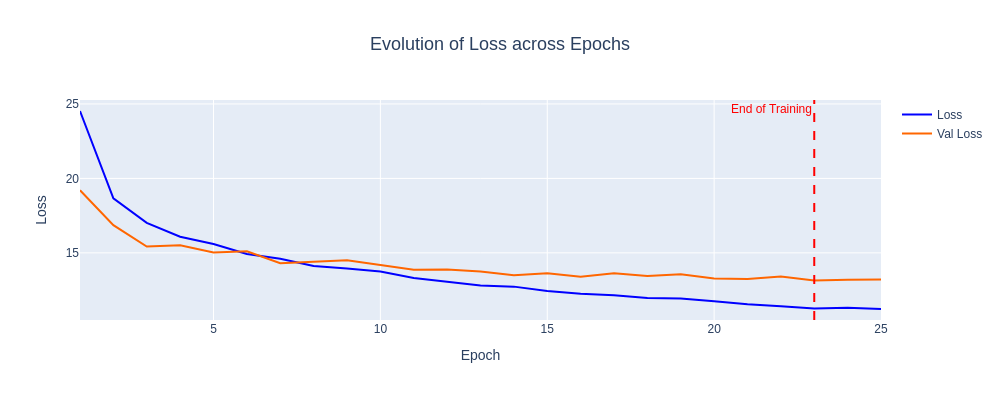

In [ ]:
plot_metrics(history)
plot_metrics(history, renderer="png")

### **Panoptic Quality**

To evaluate the performance of panoptic segmentation models, which combine semantic and instance segmentation, the [Panoptic Quality (PQ)](https://arxiv.org/pdf/1801.00868) metric is used. PQ is a unified metric that measures both **stuff** and **thing** classes and is defined as:

$$
\text{PQ} = \frac{\sum_{(p,g) \in TP} \text{IoU}(p, g)}{|TP| + \frac{1}{2}|FP| + \frac{1}{2}|FN|}
$$

where $\sum_{(p,g) \in TP} \text{IoU}(p, g)$ represents the sum of the IoU values for all correctly matched pairs (TP).

#### **Matching Rule**

A predicted segment and a ground truth segment are considered matched only if their IoU is greater than 0.5:

$$
\text{IoU}(p, g) = \frac{|p \cap g|}{|p \cup g|} > 0.5
$$

#### **Definitions**

- **True Positives (TP):** Pairs of predicted and ground truth segments correctly matched (IoU > 0.5).  
- **False Positives (FP):** Predicted segments that do not match any ground truth segment.  
- **False Negatives (FN):** Ground truth segments that do not have a matching predicted segment.

#### **Decomposition of PQ**

The PQ metric can be decomposed into two components:

1. **Segmentation Quality (SQ):**  
   Measures the average IoU of the matched segments:
   $$
   \text{SQ} = \frac{\sum_{(p,g) \in TP} \text{IoU}(p, g)}{|TP|}
   $$

2. **Recognition Quality (RQ):**  
   Evaluates the system’s ability to correctly detect instances, similar to an F1 score:
   $$
   \text{RQ} = \frac{|TP|}{|TP| + \frac{1}{2}|FP| + \frac{1}{2}|FN|}
   $$

These components are related as follows:

$$
\text{PQ} = \text{SQ} \times \text{RQ}
$$

In [10]:
# Load the fine-tuned model
model = AutoModelForUniversalSegmentation.from_pretrained(trained_model_path).to(device)

In [ ]:
# Instantiate the Panoptic Quality metric from TorchMetrics
panoptic_quality = PanopticQuality(
    things=things, stuffs=stuffs,
    allow_unknown_preds_category=True,
    return_sq_and_rq=True,
    return_per_class=True
).to(device)

The [Panoptic Quality](https://lightning.ai/docs/torchmetrics/stable/detection/panoptic_quality.html) metric from TorchMetrics requires the ground truth and predicted masks to be in the format `(batch_size, Height, Width, 2)`, where the last dimension contains the `(category_id, instance_id)` pair. Therefore, it is necessary to convert the masks to this format before evaluation.

In [ ]:
# Function to convert instance masks to the format required by Panoptic Quality
def instance_to_panoptic_masks(instance_masks, inst2class_list):
  masks_pq = []

  for mask_ids, inst2class in zip(instance_masks, inst2class_list):
    mask_cls = np.ones_like(mask_ids) * ignore_cls

    for id, cls in inst2class.items():
      mask_cls[mask_ids == id] = cls

    mask_pq = np.stack([mask_cls, mask_ids], axis=2)
    masks_pq.append(mask_pq)

  masks_pq = np.stack(masks_pq, axis=0)
  masks_pq = torch.tensor(masks_pq, dtype=torch.int32)

  return masks_pq


# Function to predict and post-process panoptic segmentation masks
def predict_panoptic(pixel_values, pixel_mask, mask_sizes=None):
  with torch.no_grad():
    outputs = model(pixel_values=pixel_values.to(device), pixel_mask=pixel_mask.to(device))

  results = image_processor.post_process_panoptic_segmentation(
    outputs,
    target_sizes=mask_sizes if mask_sizes else [image_size for _ in range(len(pixel_values))],
    label_ids_to_fuse=stuffs
  )

  masks = [result["segmentation"].cpu().numpy() for result in results]
  segments_info_list = [result["segments_info"] for result in results]

  return masks, segments_info_list

In [ ]:
# Evaluate the fine-tuned model on the validation set

for idx in tqdm(range(0, len(val_dataset), batch_size)):
  batch = val_dataset[idx: idx + batch_size]
  
  # Resize ground truth masks
  masks = [
      np.array(mask.resize(image_size[::-1], Image.Resampling.NEAREST))
      for mask in batch["mask"]
  ]

  # Map instance IDs to category IDs for ground truth
  inst2class_list = [
      {segment_info["id"]: segment_info["category_id"] for segment_info in segments_info}
      for segments_info in batch["segments_info"]
  ]
  
  # Predict instance masks and segments info
  masks_pred, segments_info_list_pred = predict_panoptic(batch["pixel_values"], batch["pixel_mask"])

  # Map instance IDs to label IDs for predictions
  inst2class_list_pred = [
      {segment_info["id"]: segment_info["label_id"] for segment_info in segments_info}
      for segments_info in segments_info_list_pred
  ]
  
  # Convert instance masks to panoptic format
  masks_pq = instance_to_panoptic_masks(masks, inst2class_list)
  masks_pq_pred = instance_to_panoptic_masks(masks_pred, inst2class_list_pred)
  
  panoptic_quality.update(masks_pq_pred.to(device), masks_pq.to(device))

  0%|          | 0/141 [00:00<?, ?it/s]

In [ ]:
# Display the evaluation results per class in a DataFrame
metric_results = panoptic_quality.compute().cpu().numpy()
metric_names = ["Panoptic Quality (PQ)", "Segmentation Quality (SQ)", "Recognition Quality (RQ)"]

metric_results = pd.DataFrame(
    metric_results,
    columns=metric_names,
    index=[id2label[cls] for cls in things + stuffs]
)
metric_results = metric_results.sort_values(by="Panoptic Quality (PQ)", ascending=False)

metric_results

,Panoptic Quality (PQ),Segmentation Quality (SQ),Recognition Quality (RQ)
water,0.988560,0.988560,1.000000
sky,0.975672,0.981215,0.994350
static obstacle,0.928714,0.934790,0.993500
float,0.630405,0.709206,0.888889
boat/ship,0.573855,0.777286,0.738281
paddle board,0.503669,0.765190,0.658228
row boats,0.367769,0.718025,0.512195
buoy,0.347948,0.734558,0.473684
swimmer,0.331048,0.669620,0.494382
other,0.311012,0.739994,0.420290


In [ ]:
# Calculate the overall metric values
metric_results.mean(axis=0)

,0
Panoptic Quality (PQ),0.564480
Segmentation Quality (SQ),0.790792
Recognition Quality (RQ),0.685656


In some official papers, the panoptic quality is also reported separately for the `thing` classes ($PQ_{th}$) and for the `stuff` classes ($PQ_{st}$). Below, these values are calculated:

In [ ]:
thing_classes = [v for k, v in id2label.items() if k in things]
thing_mask = metric_results.index.isin(thing_classes)

PQth = metric_results[thing_mask]["Panoptic Quality (PQ)"].mean()
PQst = metric_results[~thing_mask]["Panoptic Quality (PQ)"].mean()

print("PQth: ", PQth)
print("PQst: ", PQst)

PQth:  0.4145417229566612
PQst:  0.9643152644798665


## **Inference with the Trained Model**

### **Create the Functions for Visualization and Inference**

In this case, instances of `stuff` classes, which are at most one per panoptic mask, will always retain their original color assigned in the LaRS dataset when visualized. On the other hand, for `thing` classes, only the first instance of each class will keep its original LaRS color, while the remaining instances in the panoptic mask will be assigned unique colors from the previously selected palette. Additionally, bounding boxes will be drawn for `thing` class instances. This ensures that no instance shares the same color with another, whether from its own class or a different class, within a given panoptic mask.

In [ ]:
# Function to compute the bounding box coordinates of a binary mask (thing classes)
def get_bbox(binary_mask):
  rows = np.any(binary_mask, axis=1)
  cols = np.any(binary_mask, axis=0)
  ymin, ymax = np.where(rows)[0][[0, -1]]
  xmin, xmax = np.where(cols)[0][[0, -1]]

  return xmin, ymin, xmax, ymax


# Function to compute the centroid of a binary mask using the median (stuff classes)
def get_center(binary_mask):
  y_indices, x_indices = np.where(binary_mask == 1)
  x = np.median(x_indices)
  y = np.median(y_indices)

  return x, y


# Function to download images from the internet
def download_images(list_urls):
  images = []
  for url in list_urls:
    response = requests.get(url)
    image = Image.open(io.BytesIO(response.content)).convert("RGB")
    images.append(image)

  return images


# Function to generate a GIF from a directory of images
def create_gif(gif_path, images_dir, fps=1):
  with imageio.get_writer(gif_path, mode="I", loop=0, fps=fps) as writer:
    image_paths = sorted(
        glob(os.path.join(images_dir, "*.png")),
        key=lambda x: int(os.path.splitext(os.path.basename(x))[0])
    )

    for path in image_paths:
      image = imageio.imread(path)
      writer.append_data(image)

In [ ]:
# Function to render panoptic segmentation annotations on an axis
def render_panoptic_annotations(ax, image, mask, segments_info, blended, with_conf, alpha):

  # Initialize the RGB mask and the set of used colors
  mask_rgb = np.zeros(mask.shape[:2] + (3,), dtype=np.uint8)
  used_colors = {(0, 0, 0)} | stuff_colors
  i = 0

  for segment_info in segments_info:
    cls = segment_info["label_id"]
    color = id2color[cls]
    name = f"{id2label[cls]} {segment_info['score']:.2f}" if (with_conf and "score" in segment_info) else id2label[cls]
    
    # Iterate through the color palette until an unused color is found
    if (cls in things) and (color in used_colors):
      while (color := palette[i]) in used_colors:
        i += 1
    used_colors.add(color)

    # Fill the RGB mask with the color corresponding to the instance ID
    mask_rgb[mask == segment_info["id"]] = list(color)

    # Compute the binary mask for the corresponding instance ID
    mask_id = (mask == segment_info["id"]).astype(np.uint8)

    # Calculate the image dimensions
    height, width = image.shape[:2]
    
    # If the class ID belongs to "things," draw its bounding box and class name
    if cls in things:
      xmin, ymin, xmax, ymax = get_bbox(mask_id)
      color = tuple(np.array(color) / 255)
      rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=1, edgecolor=color, facecolor="none")

      # Adjust text positioning to prevent overlap with image boundaries
      x, ha = (xmin, "left") if xmax < (0.9 * width) else (xmax, "right")
      y, va = (ymin, "bottom") if ymin > (0.1 * height) else (ymax, "top")

      ax.add_patch(rect)
      ax.text(
          x, y, name, fontsize=7,
          color="black", fontweight="bold", ha=ha, va=va,
          bbox={"boxstyle": "square,pad=0", "facecolor": color, "edgecolor": color, "alpha": 0.7}
      )
    
    # If the class ID belongs to "stuff," display only the class name
    else:
      x, y = get_center(mask_id)

      # Adjust text positioning to prevent overlap with image boundaries
      ha = "center" if (0.1 * width) < x < (0.9 * width) else ("left" if x <= (0.1 * width) else "right")
      va = "center" if (0.1 * height) < y < (0.9 * height) else ("top" if y <= (0.1 * height) else "bottom")

      ax.text(
          x, y, name, fontsize=8,
          color="white", fontweight="bold", ha=ha, va=va,
          bbox={"boxstyle": "square,pad=0", "facecolor": "black", "alpha": 0.7}
      )
  
  # Merge the RGB mask with the image if enabled
  if blended:
    mask_rgb = cv2.addWeighted(image / 255, 1 - alpha, mask_rgb / 255, alpha, 0)

  ax.imshow(mask_rgb)
  ax.axis("off")

In [ ]:
# Function to perform image inference and visualize its predictions
def image_inference(images, n_samples=2, from_url=False, shuffle=True, blended=True,
                    with_conf=True, alpha=0.5, save=False, path_save=""):
  
  # Select sample images, shuffle if required
  sample_images = random.sample(images, n_samples) if shuffle else images[:n_samples]

  # Download images if required
  sample_images = download_images(sample_images) if from_url else sample_images

  # Prepare the image sizes for post-process
  mask_sizes = [image.size[::-1] for image in sample_images]
  
  # Process images and get predictions
  inputs = image_processor(sample_images, return_tensors="pt")
  masks, segments_info_list = predict_panoptic(inputs["pixel_values"], inputs["pixel_mask"], mask_sizes)
  
  # Create a plot for visualization
  fig, axes = plt.subplots(n_samples, 1, figsize=(9.6, n_samples * 4.8))
  axes = axes if n_samples > 1 else [axes]
  
  # Render the predictions on the images
  for ax, image, mask, segments_info in zip(axes, sample_images, masks, segments_info_list):
    image = np.array(image)
    mask = np.array(mask)
    render_panoptic_annotations(ax, image, mask, segments_info, blended, with_conf, alpha)

  plt.tight_layout()

  # Save image if configured
  if save:
    plt.savefig(path_save, bbox_inches="tight", pad_inches=0)

  plt.show()


# Function for video inference that returns a GIF of the predictions
def video_inference(video_path, gif_path, batch_size=batch_size, show=True):

  # Create directory for frames if it doesn't exist
  images_dir = os.path.join(os.getcwd(), "images")
  if os.path.exists(images_dir):
    shutil.rmtree(images_dir)
  os.makedirs(images_dir)
  
  # Open the video file
  cap = cv2.VideoCapture(video_path)
  height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
  width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
  fps = cap.get(cv2.CAP_PROP_FPS)
  
  # Process video frames in batches
  while cap.isOpened():
    batch_frames = []
    
    # Read a batch of frames
    for _ in range(batch_size):
      success, frame = cap.read()
      if not success:
        break

      batch_frames.append(frame[..., ::-1])

    if not batch_frames:
      break
    
    # Process the frames and get predictions
    inputs = image_processor(batch_frames, do_resize=False, return_tensors="pt")
    mask_sizes = [(height, width) for _ in range(len(batch_frames))]
    masks, segments_info_list = predict_panoptic(inputs["pixel_values"], inputs["pixel_mask"], mask_sizes)
    
    # Render predictions and save frames as images
    for image, mask, segments_info in zip(batch_frames, masks, segments_info_list):
      fig, ax = plt.subplots(1, 1, figsize=(width / 100, height / 100))
      render_panoptic_annotations(ax, image, mask, segments_info, blended=True, with_conf=True, alpha=0.5)

      plt.tight_layout()
      plt.savefig(
          os.path.join(images_dir, f"{len(os.listdir(images_dir))}.png"),
          bbox_inches="tight",
          pad_inches=0
      )
      plt.close()
  
  # Release video capture and cleanup
  cap.release()
  cv2.destroyAllWindows()
  
  # Create the GIF from saved images
  create_gif(gif_path, images_dir, fps=fps)
  
  # Optionally display the generated GIF
  if show:
    display(DisplayImage(gif_path))

### **Validation Dataset**

In [ ]:
val_images = dataset["val"]["image"]

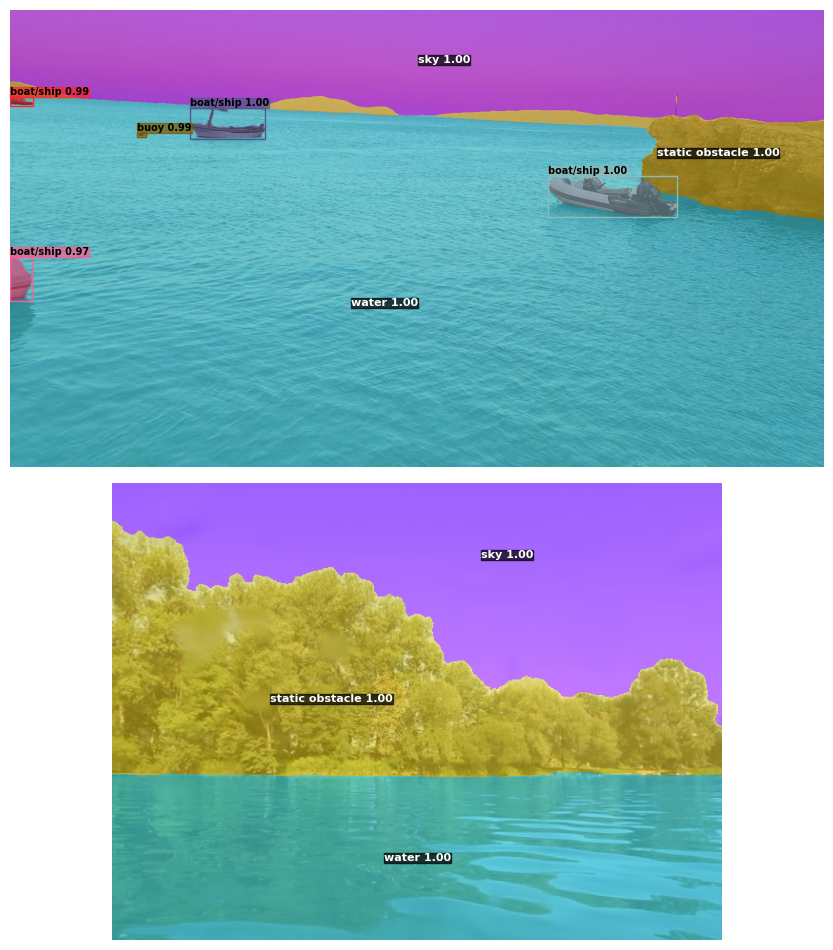

In [ ]:
image_inference(val_images)

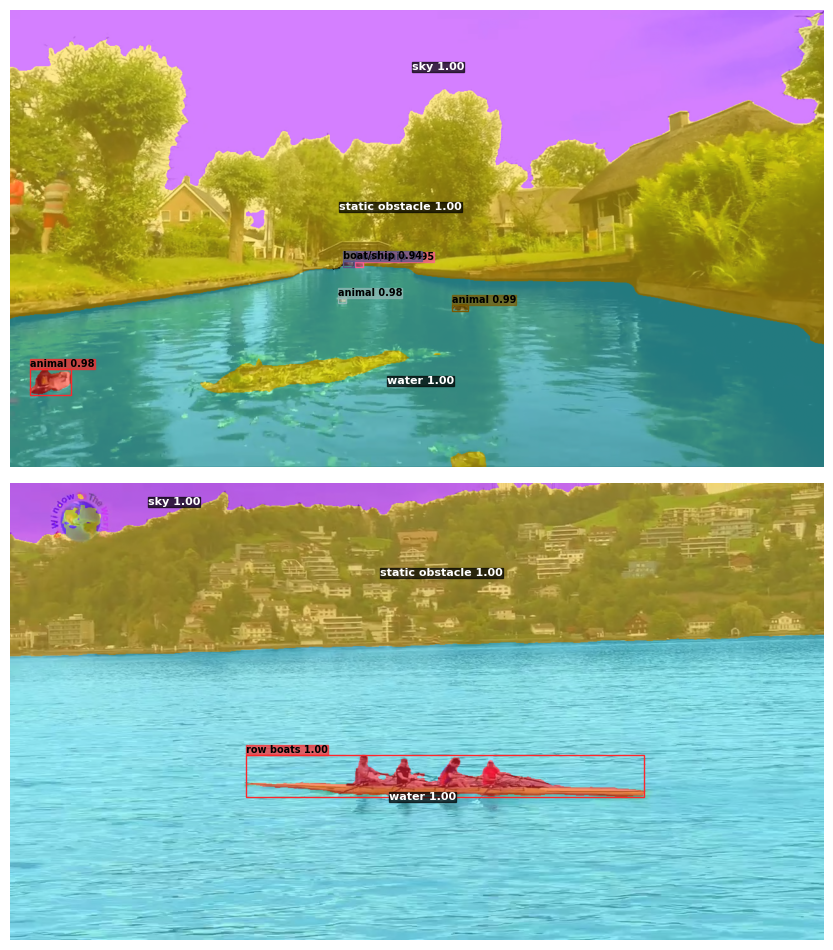

In [ ]:
image_inference(val_images)

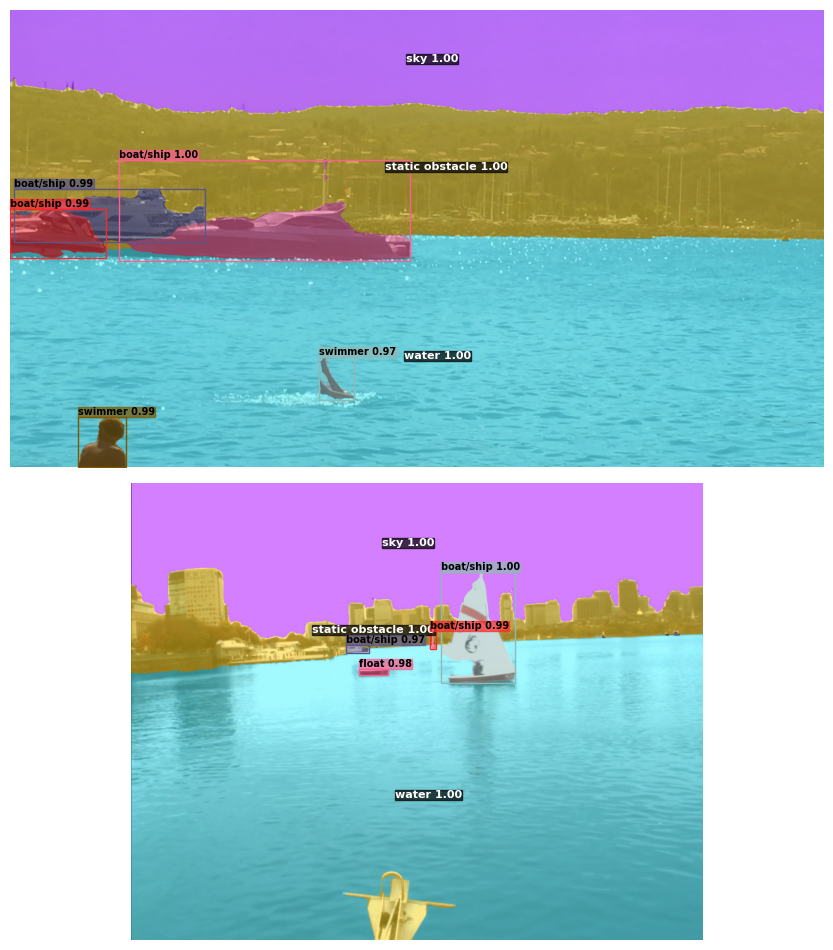

In [ ]:
image_inference(val_images)

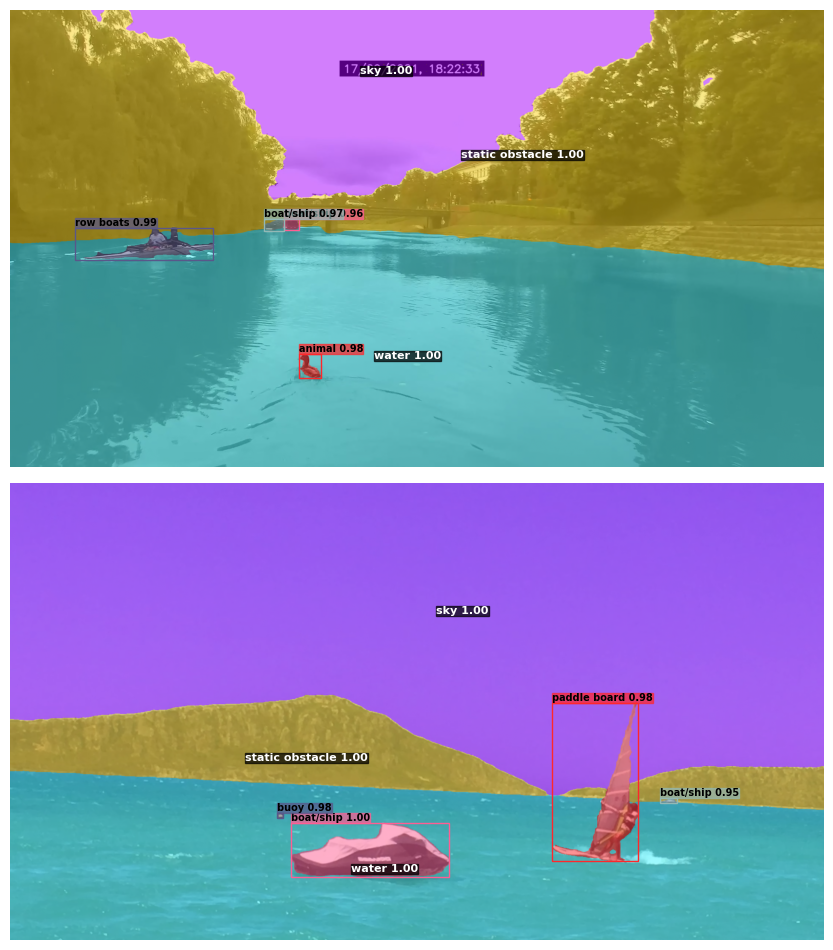

In [ ]:
image_inference(val_images)

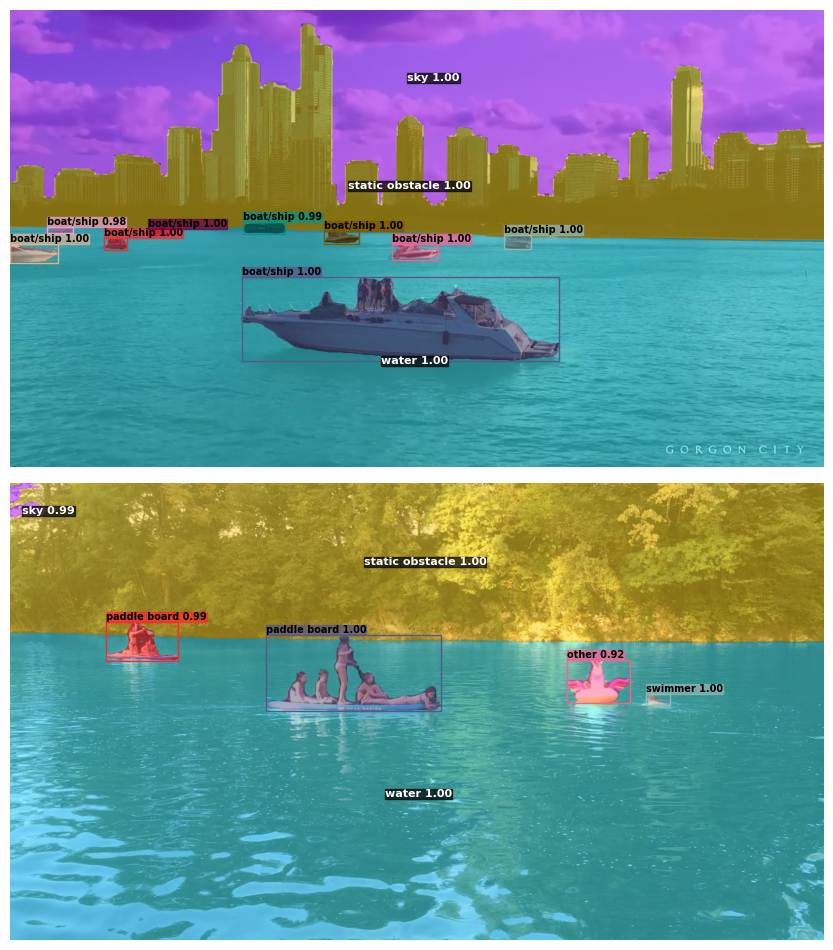

In [ ]:
image_inference(val_images, save=True, path_save="PanopticSegmentation_Mask2Former-Tiny_LaRS_1.png")

### **Internet Images**

In [ ]:
list_urls = [
    "https://images.pexels.com/photos/11020972/pexels-photo-11020972.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://image.kkday.com/v2/image/get/w_960%2Cc_fit%2Cq_55%2Ct_webp/s1.kkday.com/product_118591/20250330200937_DYgC9/png",
    "https://cdn1.yumping.com/emp/fotos/28/P/078699/640/p-78699-clases-de-windsurf-en-tarifa1652270499_16522705562361.jpg",
    "https://keyassets.timeincuk.net/inspirewp/live/wp-content/uploads/sites/20/2015/11/LR37-Expert-Mooring-by-sail.jpg",
    "https://porttopub.com.au/wp-content/uploads/2025/02/Photo-Important-Details-1.jpg",
    "https://www.portseurope.com/wp-content/uploads/2024/08/pexels-photo-2433110.jpeg"
]

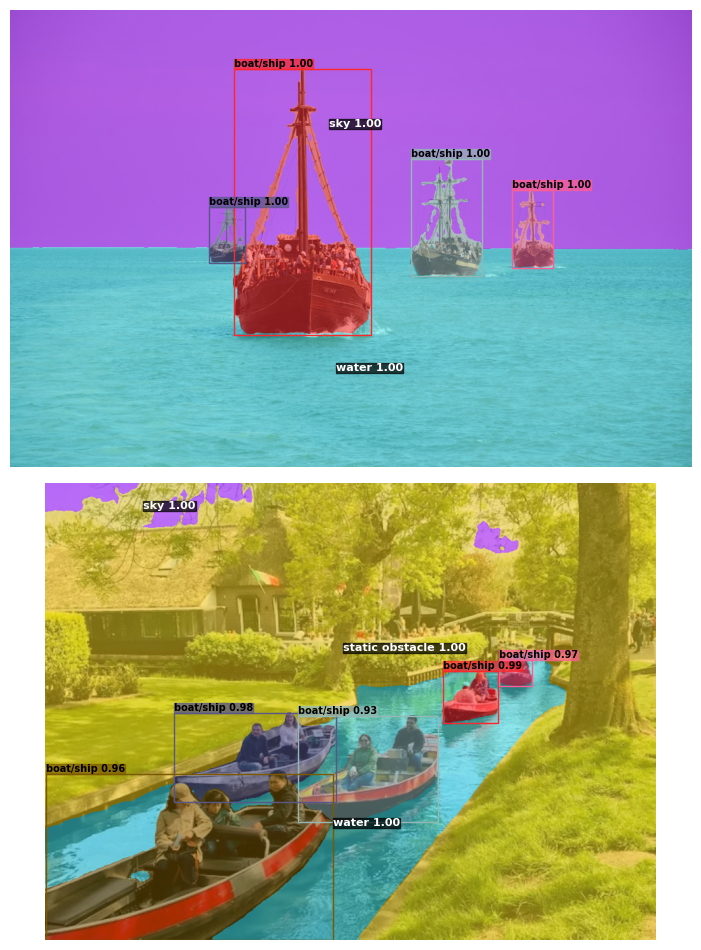

In [ ]:
image_inference(list_urls[:2], from_url=True, shuffle=False)

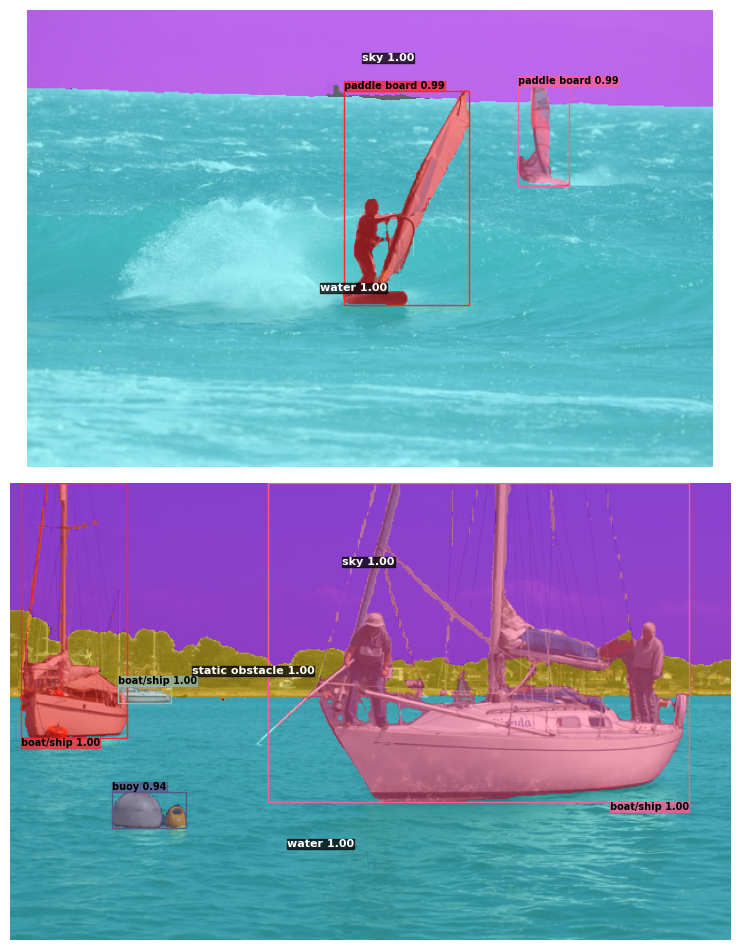

In [ ]:
image_inference(list_urls[2:], from_url=True, shuffle=False)

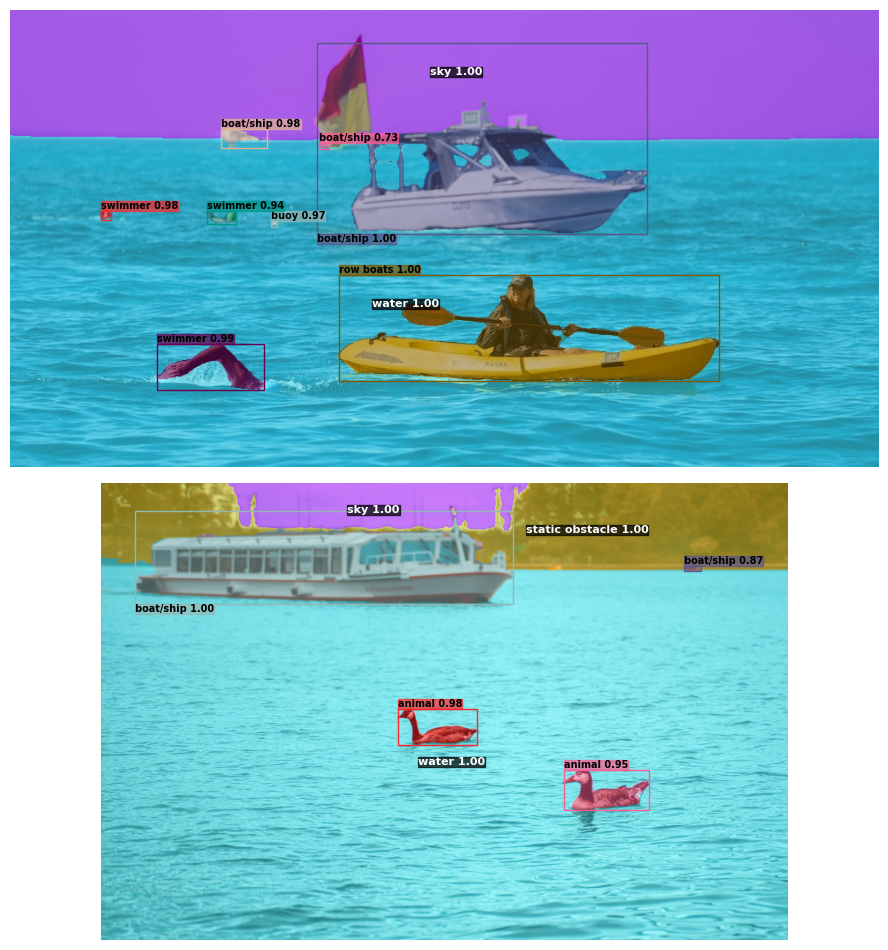

In [ ]:
image_inference(
    list_urls[4:], from_url=True, shuffle=False,
    save=True, path_save="PanopticSegmentation_Mask2Former-Tiny_LaRS_2.png"
)

### **Video Inference**

The video used for inference is available on YouTube at the [following link](http://youtube.com/watch?v=rf66UO_KBdY&t=1s). To speed up the process, only a small excerpt of the video is used for the demonstration.

In [16]:
video_paths = [
    "/content/drive/MyDrive/Videos/LaRS.mp4",
]

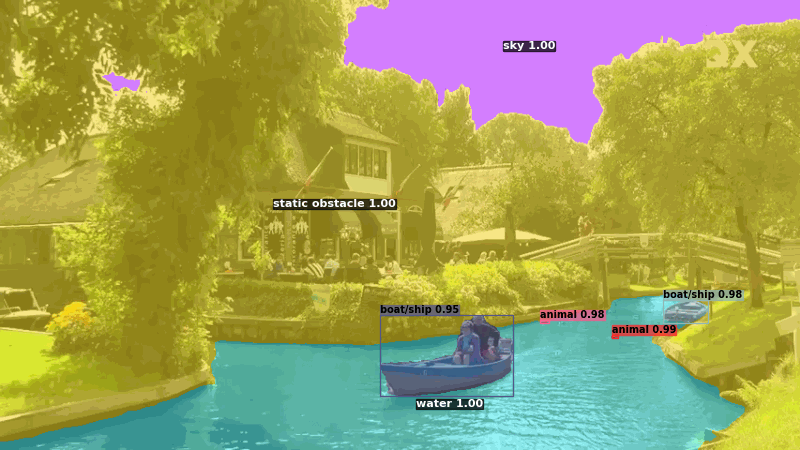

In [27]:
video_inference(video_paths[0], "PanopticSegmentation_Mask2Former-Tiny_LaRS.gif")

## **Conclusion**

The **Mask2Former-Swin-Tiny** model, fine-tuned with the **LaRS** dataset, has shown competitive performance, achieving a **Panoptic Quality (PQ) of 0.564** on the validation set. This score would place it in second position on the current [official LaRS GitHub leaderboard](https://lojzezust.github.io/lars-dataset/) if extrapolated to the non-public test set.

Despite the computational limitations of the free Google Colab GPU which only allows a reduced image size of `(512, 832)` and the use of the smallest Mask2Former version the model outperforms the **PanSR (RN-50)** in second place (**0.542**) and gets very close to **PanSR (Swin-L)** (**0.573**) in terms of PQ. This highlights the effectiveness of the fine-tuning techniques even with limited resources.

However, the gap in **$PQ_{th}$ (0.415 vs. the leader's 0.430)** shows difficulties in segmenting *thing* classes, especially small instances like `other` (PQ: 0.311) and `animal` (PQ: 0.251), which would benefit from larger image sizes to improve performance. On the other hand, *stuff* classes like `water` (PQ: 0.989) achieve almost perfect results thanks to their homogeneity, resulting in a lower **RQ (0.686)** compared to the **SQ (0.791)** achieved.

To achieve better results, it is recommended to use more powerful models like **Mask2Former-Swin-Large** or versions of **OneFormer**, which perform better than Mask2Former in different benchmarks. It would also be advisable to use images with a minimum resolution of `(512, 1024)` during fine-tuning to better capture fine details. Additionally, increasing the number of annotated images, especially those containing *thing* classes with fewer instances seen during LaRS preprocessing, would be beneficial. However, all these improvements would require greater computing power. Nevertheless, despite these limitations, the model achieved a considerable performance as demonstrated in the evaluation and inference.